**Zadanie 0**

Zapoznać się z metodą całkowania sc.integrate.solve_ivp z modułu
SciPy. Warto skopiować i uruchomić program, wykreślający
oryginalny atraktor Lorentza, opisany na blogu:
https://www.johndcook.com/blog/2020/01/26/lorenz-system/
W razie wątpliwości warto też sprawdzić dokumentację:
https://docs.scipy.org/doc/scipy/reference/generated/scipy.integrate.
solve˙ivp.html

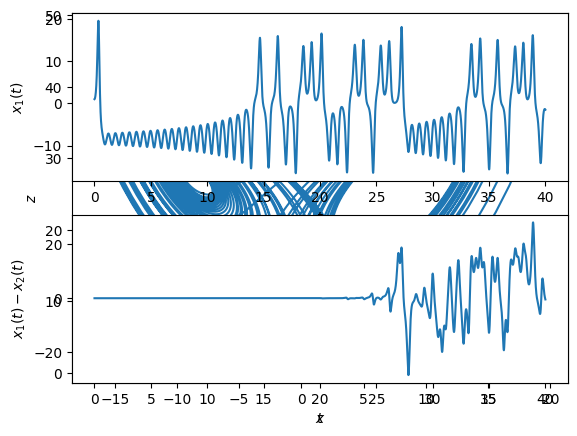

In [1]:
import numpy as np
from scipy.integrate import solve_ivp
import matplotlib.pyplot as plt
import os

os.makedirs('images', exist_ok=True)

def lorenz(t, xyz):
    x, y, z = xyz
    s, r, b = 10, 28, 8/3. # parameters Lorentz used
    return [s*(y-x), x*(r-z) - y, x*y - b*z]

a, b = 0, 40
t = np.linspace(a, b, 4000)

sol1 = solve_ivp(lorenz, [a, b], [1,1,1], t_eval=t)
sol2 = solve_ivp(lorenz, [a, b], [1,1,1.00001], t_eval=t)

plt.plot(sol1.y[0], sol1.y[2])
plt.xlabel("$x$")
plt.ylabel("$z$")
plt.savefig("images/lorenz_xz.png")

plt.subplot(211)
plt.plot(sol1.t, sol1.y[0])
plt.xlabel("$t$")
plt.ylabel("$x_1(t)$")
plt.subplot(212)
plt.plot(sol1.t, sol1.y[0] - sol2.y[0])
plt.ylabel("$x_1(t) - x_2(t)$")
plt.xlabel("$t$")
plt.savefig("images/lorenz_x.png")

Rozwiązać układ równań różniczkowych (ang. ODE) opisujących ewolucję cząstki w potencjale z podwójnym minimum, siłą wymuszającą i tłumieniem (tzw. równanie Duffinga):

\begin{cases}
\dot{x} = v \\
\dot{v} = bx - a x^{3} - c v + f \cos(\omega t)
\end{cases}


przy ustalonych następujących parametrach:
\( a = 1, \quad b = 1, \quad c = 0.2, \quad \omega / 2\pi = 0.213 \).

Przy pomocy biblioteki **matplotlib** wykreślić:
a) zależność \( x(t) \) oraz \( v(t) \)
b) ewolucję układu w przestrzeni fazowej z warunkiem początkowym
\( x(t = 0) = 0, \quad v(t = 0) = 0.15 \)
i przy amplitudzie pobudzania \( f = 0.2 \).

Na wykresach proszę opisać osie, w tytule umieścić parametr \( f \), dodać legendę linii w razie potrzeby. Zaznaczyć położenie równowagi.


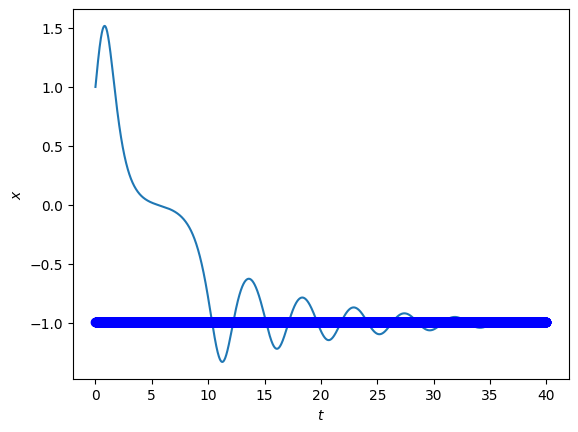

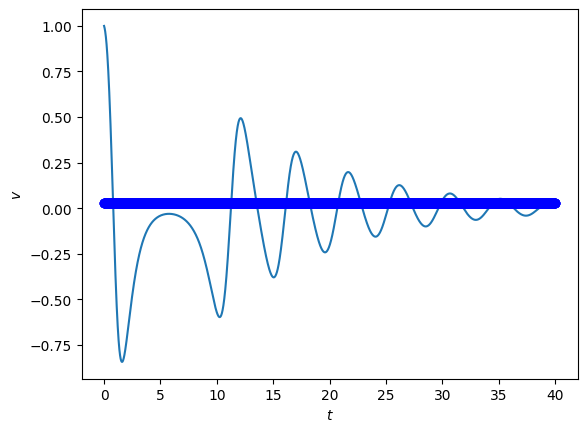

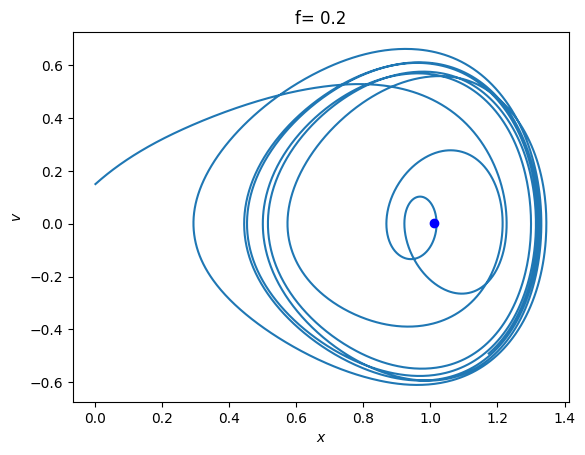

In [2]:
import numpy as np
from scipy.integrate import solve_ivp
import matplotlib.pyplot as plt
import os

os.makedirs('images', exist_ok=True)

f = 0
f_1 = 0.2

def duffing(t, xv):
    x, v = xv
    a, b, c, ω = 1, 1, 0.2, 2*np.pi*0.213
    return [v, b*x - (x**3 * a ) - (c*v) + (f * np.cos(ω*t)) ]


a, b = 0, 40
t = np.linspace(a, b, 4000)


sol1 = solve_ivp(duffing, [a, b], [1,1], t_eval=t)

f=0
sol4 = solve_ivp(duffing, [a, b], [1,1], t_eval=t)


plt.plot(sol1.t, sol1.y[0])
plt.plot(sol4.t, np.full(4000, sol4.y[0][3999]), 'bo')
plt.xlabel("$t$")
plt.ylabel("$x$")
plt.savefig("images/lorenz_xt.png")
plt.show()

plt.plot(sol1.t, sol1.y[1])
plt.plot(sol4.t, np.full(4000, sol4.y[1][3999]), 'bo')
plt.xlabel("$t$")
plt.ylabel("$v$")
plt.savefig("images/lorenz_vt.png")
plt.show()

f = f_1
sol2 = solve_ivp(duffing, [a, b], [0,0.15], t_eval=t)

f = 0
sol3 = solve_ivp(duffing, [a, b], [0,0.15], t_eval=t)

plt.plot(np.full(4000, sol2.y[0]), np.full(4000, sol2.y[1]))
plt.plot(sol3.y[0][3999], sol3.y[1][3999], 'bo')
plt.xlabel("$x$")
plt.ylabel("$v$")
plt.title(f"f= {f_1}")
plt.savefig("images/lorenz_xv.png")
plt.show()

t = np.linspace(a, b, 4000)

W tym zadaniu wykreślamy portrety fazowe trajektorii (x(t),v(t))
otrzymywane w zagadnieniu Duffinga, ale tylko dla odpowiednio
długich czasów ewolucji (np. t >200). Wybrać warunki początkowe w
pobliżu położenia równowagi.
Należy poeskperymentować z wartością f tak, aby znaleźć
charakterystyczne rozwiązania oscylacyjne wokół jednego położenia
równowagi:
▶ z pojedynczym okresem
▶ z podwójnym okresem
▶ a nawet z poczwórnym okresem
Poszukać rozwiązań z “przełączaniem” między punktami równowagi:
▶ zaproponować “graniczną” najmniejszą wartość f, dla której
pojawia się już chaos.
Wyniki zadania ilustrować wykresami w przestrzeni fazowej
zachowania układu w długim czasie (atraktor).

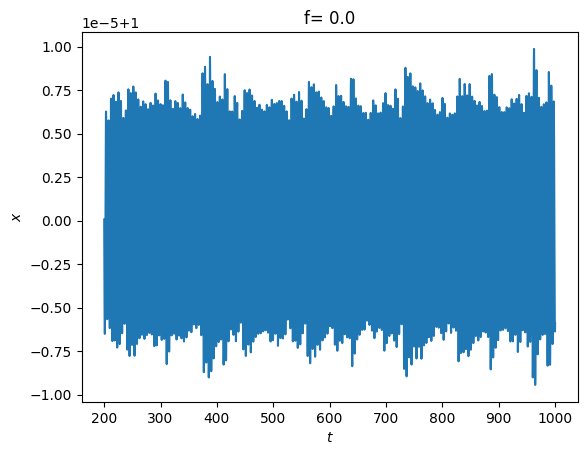

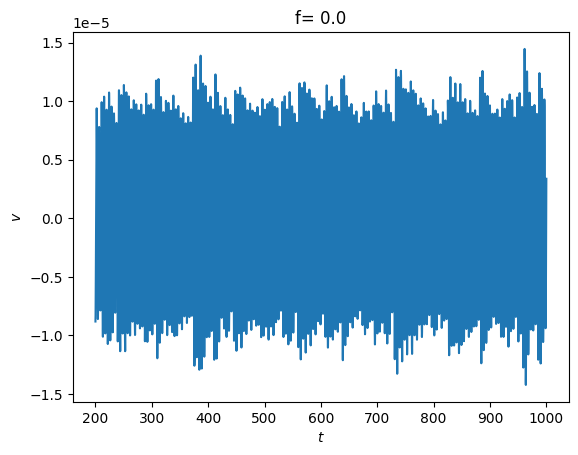

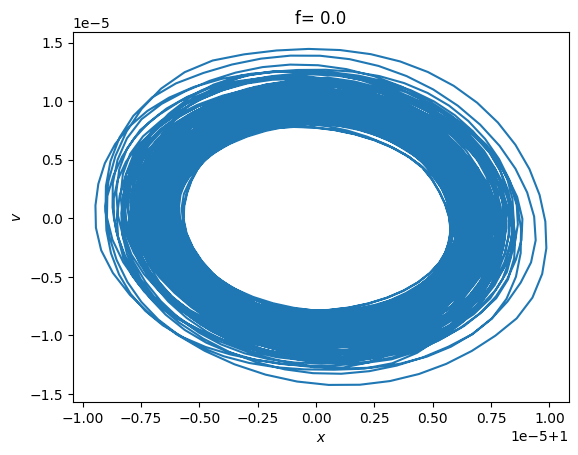

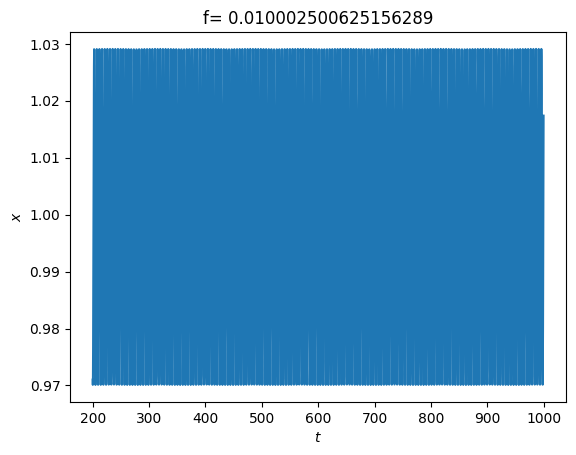

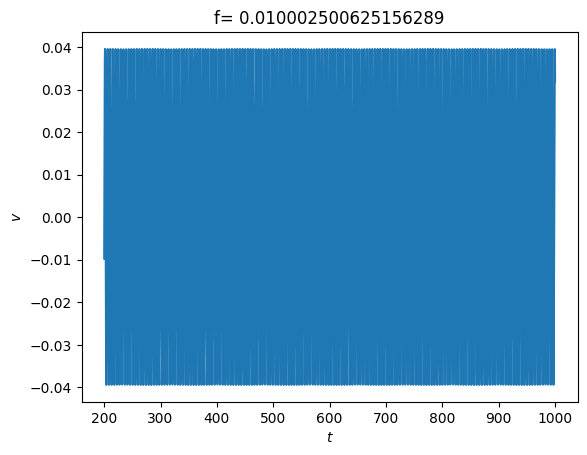

...

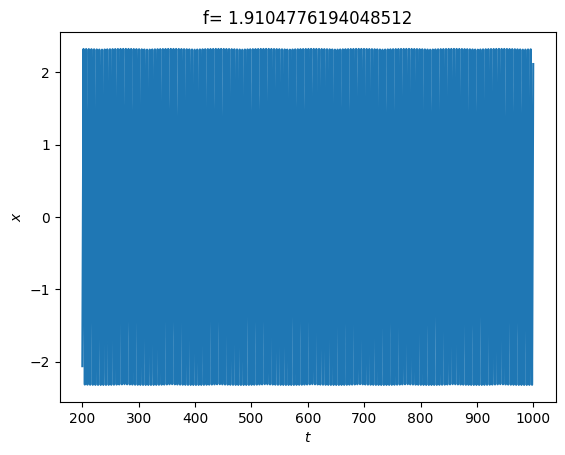

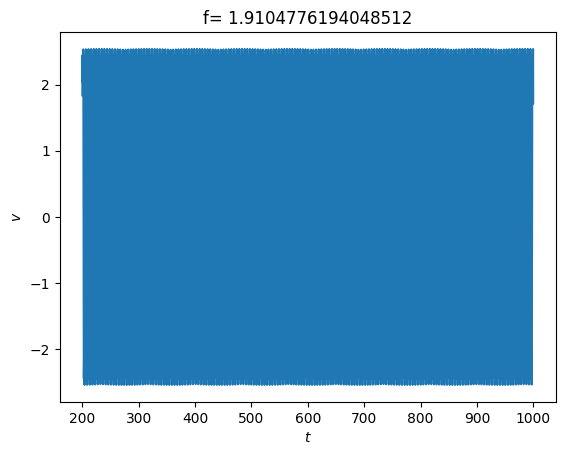

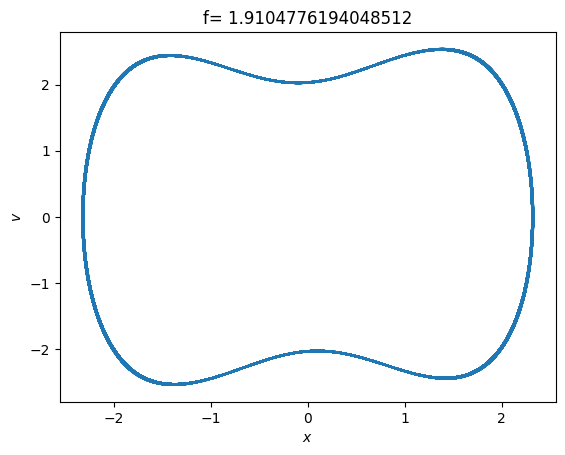

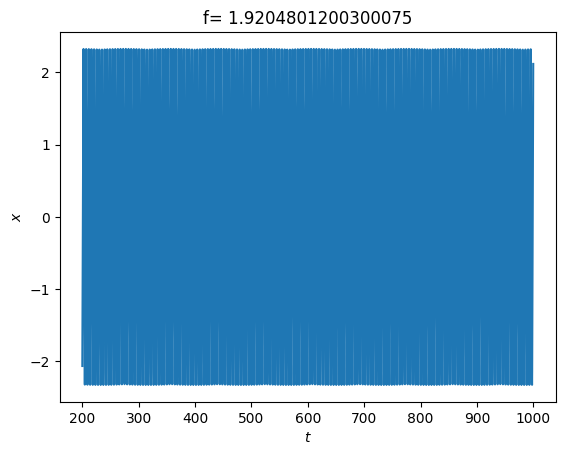

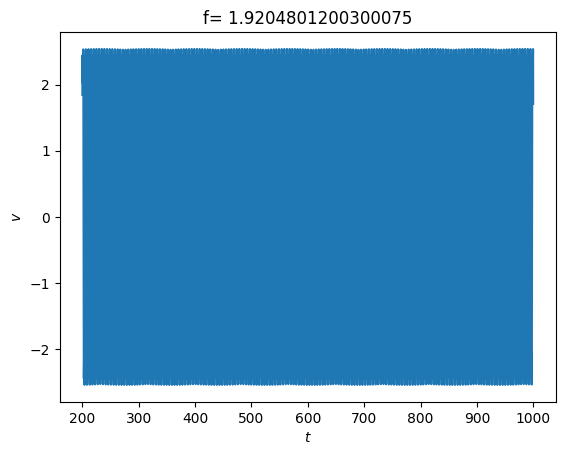

In [ ]:
import numpy as np
from scipy.integrate import solve_ivp
import matplotlib.pyplot as plt
import os

os.makedirs('images', exist_ok=True)


def duffing(t, xv, f):
    x, v = xv
    a, b, c, ω = 1, 1, 0.2, 2*np.pi*0.213
    return [v, b*x - (x**3 * a ) - (c*v) + (f * np.cos(ω*t)) ]

def drawDuffingFor(f):
    a, b = 0, 1000
    t = np.linspace(a, b, 10000)
    sol1 = solve_ivp(duffing, [a, b], [0,0.15], t_eval=t, args=(f,))

    plt.plot(sol1.t[2000:], sol1.y[0][2000:])
    plt.xlabel("$t$")
    plt.ylabel("$x$")
    plt.title(f"f= {f}")
    plt.savefig("images/lorenz_xt.png")
    plt.show()

    plt.plot(sol1.t[2000:], sol1.y[1][2000:])
    plt.xlabel("$t$")
    plt.ylabel("$v$")
    plt.title(f"f= {f}")
    plt.savefig("images/lorenz_vt.png")
    plt.show()

    plt.plot(sol1.y[0][2000:], sol1.y[1][2000:])
    plt.xlabel("$x$")
    plt.ylabel("$v$")
    plt.title(f"f= {f}")
    plt.savefig("images/lorenz_xv.png")
    plt.show()

a, b = 0, 40
dfs = np.linspace(a, b, 4000)

for df in dfs:
    drawDuffingFor(df)
